<a href="https://colab.research.google.com/github/ashishsaini01/Anomaly_detection_using_autoencoders/blob/main/loco_resnet_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 22.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp39-cp39-linux_x86_64.whl size=44089 sha256=cce05e1eadaf5b1ffe2fe87564ba5d476e403f103063f9112d80b8e6fd7d1ddc
  Stored in directory: /root/.cache/pip/wheels/68/be/8f/b6c454cd264e0b349b47f8ee00755511f277618af9e5dae20d
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
flax 0.6.8 requires PyYAML>=5.4.1, but you have pyyaml 5.1 which is incompatible.
dask 2022.12.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.

In [2]:
!git clone https://github.com/tum-fml/loco

Cloning into 'loco'...
remote: Enumerating objects: 37, done.
remote: Counting objects: 100% (4/4), done.
remote: Compressing objects: 100% (4/4), done.
remote: Total 37 (delta 0), reused 0 (delta 0), pack-reused 33
Unpacking objects: 100% (37/37), 17.42 MiB | 4.99 MiB/s, done.


In [3]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.0 ; cuda:  cu118
detectron2: 0.6


In [ ]:
# crearting json file with annotations for train and val

In [ ]:
import json
with open('/content/loco/rgb/loco-sub1-v1-val.json') as f:
  v1 = json.load(f)

In [ ]:
import json
with open('/content/loco/rgb/loco-sub2-v1-train.json', 'r') as f:
    json_file_sub2 = json.load(f)

with open('/content/loco/rgb/loco-sub3-v1-train.json', 'r') as f:
    json_file_sub3 = json.load(f)

with open('/content/loco/rgb/loco-sub5-v1-train.json', 'r') as f:
    json_file_sub5 = json.load(f)

In [ ]:
import json
with open('/content/loco/rgb/loco-sub1-v1-val.json', 'r') as f:
    json_file_sub1 = json.load(f)

with open('/content/loco/rgb/loco-sub4-v1-val.json', 'r') as f:
    json_file_sub4 = json.load(f)

In [ ]:
json_file_sub2.keys(), json_file_sub3.keys(), json_file_sub5.keys()

(dict_keys(['images', 'categories', 'annotations']),
 dict_keys(['images', 'categories', 'annotations']),
 dict_keys(['images', 'categories', 'annotations']))

In [ ]:
len(json_file_sub2['images']), len(json_file_sub2['categories']), len(json_file_sub2['annotations'])

(1070, 5, 41681)

In [ ]:
len(json_file_sub3['annotations']), len(json_file_sub5['annotations'])

(26627, 18628)

In [ ]:
json_file_sub2['images'].extend(json_file_sub3['images'])
json_file_sub2['images'].extend(json_file_sub5['images'])

json_file_sub2['annotations'].extend(json_file_sub3['annotations'])
json_file_sub2['annotations'].extend(json_file_sub5['annotations'])

In [ ]:
# for val 
json_file_sub1['images'].extend(json_file_sub4['images'])
json_file_sub1['annotations'].extend(json_file_sub4['annotations'])

In [ ]:
len(json_file_sub2['images']), len(json_file_sub2['categories']), len(json_file_sub2['annotations'])

(2820, 5, 86936)

In [ ]:
# changing path of images
for item in json_file_sub1['images']:
    item['path'] = item['path'].split('/')
    item['path'] = '/' + item['path'][1] + '/' + 'val' + '/' + item['path'][-1]

In [ ]:
json_file_sub1['images'][0]

{'id': 9526,
 'dataset_id': 12,
 'path': '/dataset/val/1564562430367,07.jpg',
 'width': 1920,
 'height': 1080,
 'file_name': '1564562430367,07.jpg'}

In [ ]:
# saving updated jason files
with open('/content/drive/MyDrive/loco_data/loco-sub2-v1-val.json', 'w') as f:
    json.dump(json_file_sub1, f)

In [4]:
import glob

In [ ]:
# fetching names of those images, which is contained in subset-2 folder
file_names = []
files = sorted(glob.glob('/content/drive/MyDrive/loco_data/val/*.jpg'))
for files in files:
  file_names.append(files.split('/')[-1])
  #entity = files[:-8].split('/')[-1]

In [ ]:
#
for entry in json_file_sub1['images']:
    if entry['file_name'] not in file_names:
      json_file_sub1['images'].remove(entry)

In [ ]:
json_file_sub1['images'][0]

{'id': 9526,
 'dataset_id': 12,
 'path': '/dataset/val/1564562430367,07.jpg',
 'width': 1920,
 'height': 1080,
 'file_name': '1564562430367,07.jpg'}

In [ ]:
with open('/content/loco-sub2-v1-val.json', 'r') as f:
    val_json = json.load(f)

In [ ]:
len(val_json['images'])

44

In [ ]:
len(json_file_sub1['images'])

2277

In [ ]:
len(file_names)

2371

In [5]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [6]:
from google.colab import drive 
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/loco_data/val.zip -d /content/drive/MyDrive/loco_data/

In [7]:
# if your dataset is in COCO format, this cell can be replaced by the following three lines:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/drive/MyDrive/loco_data/loco-sub2-v1-train.json", "/content/drive/MyDrive/loco_data/train")
register_coco_instances("my_dataset_val", {}, "/content/drive/MyDrive/loco_data/loco-sub2-v1-val.json", "/content/drive/MyDrive/loco_data/val")


In [ ]:
DatasetCatalog.clear()

In [8]:
train_metadata = MetadataCatalog.get("my_dataset_train")
train_catalog = DatasetCatalog.get("my_dataset_train")

[04/20 17:55:16 d2.data.datasets.coco]: Loading /content/drive/MyDrive/loco_data/loco-sub2-v1-train.json takes 3.42 seconds.
WARNING [04/20 17:55:16 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

WARNING [04/20 17:55:16 d2.data.datasets.coco]: /content/drive/MyDrive/loco_data/loco-sub2-v1-train.json contains 98268 annotations, but only 86936 of them match to images in the file.
[04/20 17:55:16 d2.data.datasets.coco]: Loaded 5615 images in COCO format from /content/drive/MyDrive/loco_data/loco-sub2-v1-train.json


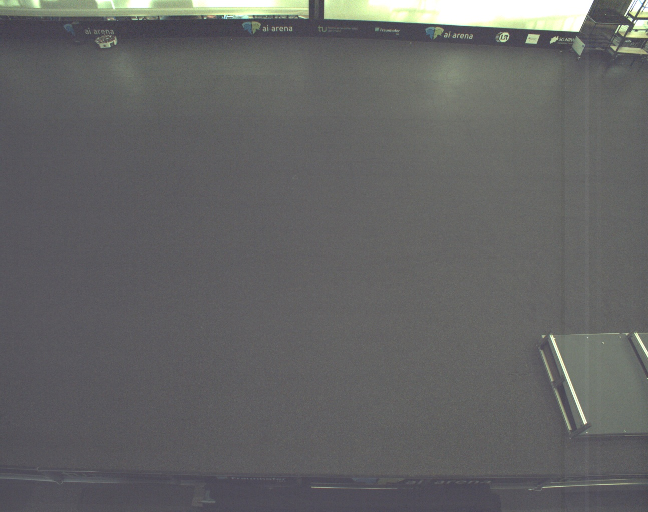

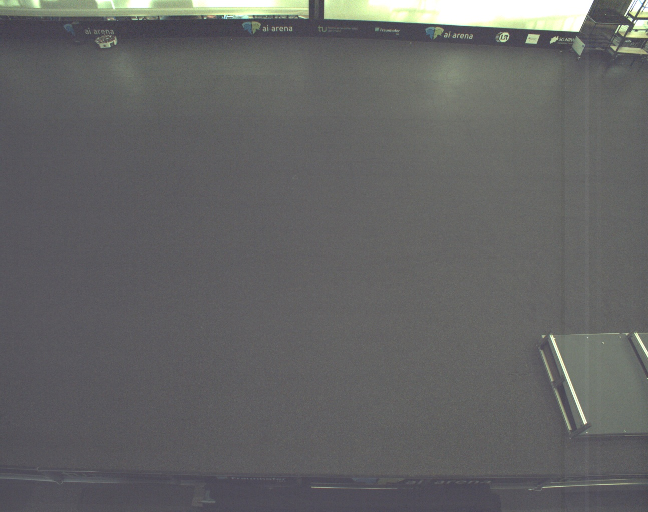

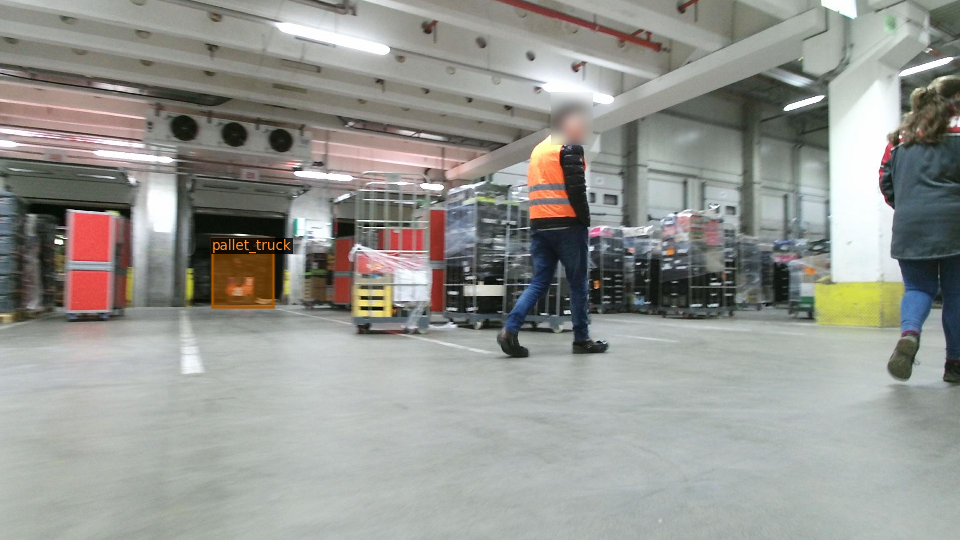

In [ ]:
dataset_dicts = train_catalog
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=train_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

In [9]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [10]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.005  # pick a good LR
cfg.SOLVER.MAX_ITER = 1500    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # The "RoIHead batch size". 128 is faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 5  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

cfg.TEST.EVAL_PERIOD = 500

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg) 
trainer.resume_or_load(resume=False)

trainer.train()

  


[04/20 17:55:22 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:00, 201MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[04/20 17:55:25 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.9/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[04/20 17:56:12 d2.utils.events]:  eta: 0:16:12  iter: 19  total_loss: 3.762  loss_cls: 1.625  loss_box_reg: 0.389  loss_rpn_cls: 1.104  loss_rpn_loc: 0.343    time: 0.6900  last_time: 0.6544  data_time: 1.5071  last_data_time: 0.1929   lr: 9.9905e-05  max_mem: 2736M
[04/20 17:56:31 d2.utils.events]:  eta: 0:15:48  iter: 39  total_loss: 1.98  loss_cls: 0.8969  loss_box_reg: 0.463  loss_rpn_cls: 0.3041  loss_rpn_loc: 0.2207    time: 0.7261  last_time: 0.8537  data_time: 0.1780  last_data_time: 0.3637   lr: 0.0001998  max_mem: 2736M
[04/20 17:56:45 d2.utils.events]:  eta: 0:16:07  iter: 59  total_loss: 1.792  loss_cls: 0.7148  loss_box_reg: 0.5305  loss_rpn_cls: 0.2787  loss_rpn_loc: 0.208    time: 0.7250  last_time: 0.7403  data_time: 0.2725  last_data_time: 0.2690   lr: 0.0002997  max_mem: 2940M
[04/20 17:56:58 d2.utils.events]:  eta: 0:15:51  iter: 79  total_loss: 1.859  loss_cls: 0.6708  loss_box_reg: 0.5868  loss_rpn_cls: 0.251  loss_rpn_loc: 0.2543    time: 0.7099  last_time: 0.756

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

#%reload_ext tensorboard

<IPython.core.display.Javascript object>

In [11]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_val")
inference_on_dataset(trainer.model, val_loader, evaluator)

[04/20 18:45:25 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
[04/20 18:45:25 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [04/20 18:45:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[04/20 18:45:27 d2.data.datasets.coco]: Loading /content/drive/MyDrive/loco_data/loco-sub2-v1-val.json takes 1.16 seconds.
WARNING [04/20 18:45:27 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[04/20 18:45:27 d2.data.datasets.coco]: Loaded 2277 images in COCO format from /content/drive/MyDrive/loco_data/loco-sub2-v1-val.json
[04/20 18:45:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[04/20 18:45:27 d2.data.

OrderedDict([('bbox',
              {'AP': 8.176030490518528,
               'AP50': 23.404281730748,
               'AP75': 3.5690349007809976,
               'APs': 2.4645152971845907,
               'APm': 6.509250740096344,
               'APl': 11.279970064082534,
               'AP-small_load_carrier': 8.053096107849825,
               'AP-forklift': 1.4999880061590012,
               'AP-pallet': 13.182126705345274,
               'AP-stillage': 11.210360738580667,
               'AP-pallet_truck': 6.934580894657873})])

In [12]:
# making cfg file
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

[04/20 18:52:22 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [ ]:
val_metadata = MetadataCatalog.get("my_dataset_val")
val_catalog = DatasetCatalog.get("my_dataset_val")

[04/19 20:06:01 d2.data.datasets.coco]: Loading /content/drive/MyDrive/loco_data/loco-sub2-v1-val.json takes 1.38 seconds.
WARNING [04/19 20:06:01 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[04/19 20:06:01 d2.data.datasets.coco]: Loaded 2277 images in COCO format from /content/drive/MyDrive/loco_data/loco-sub2-v1-val.json


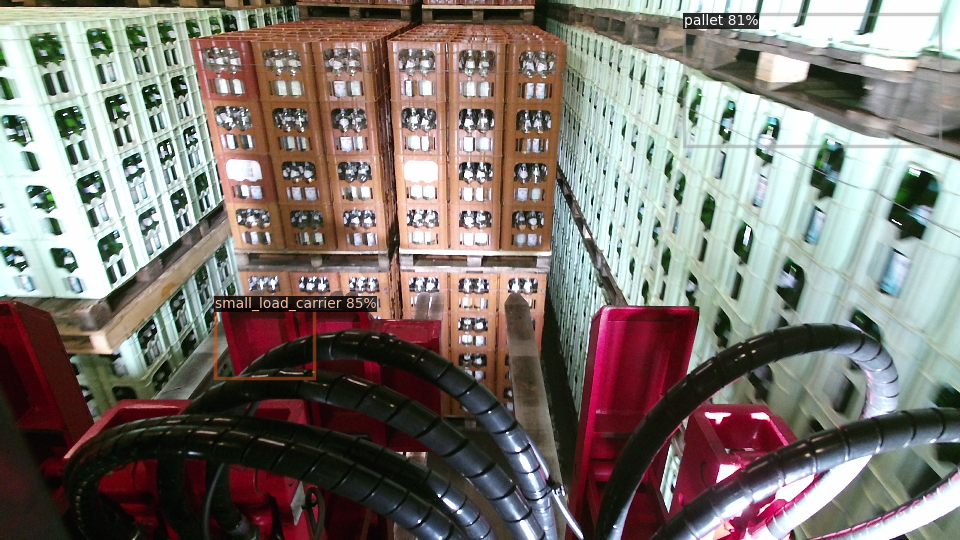

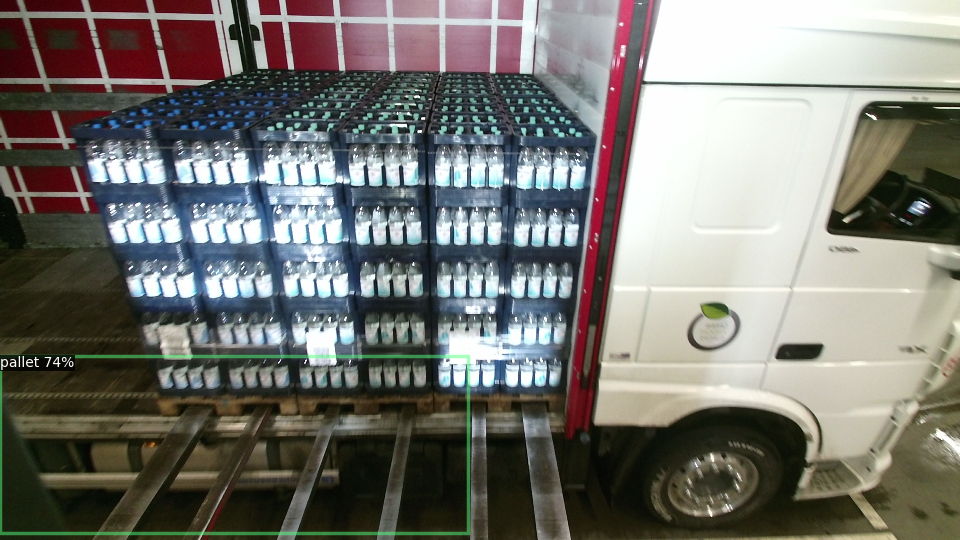

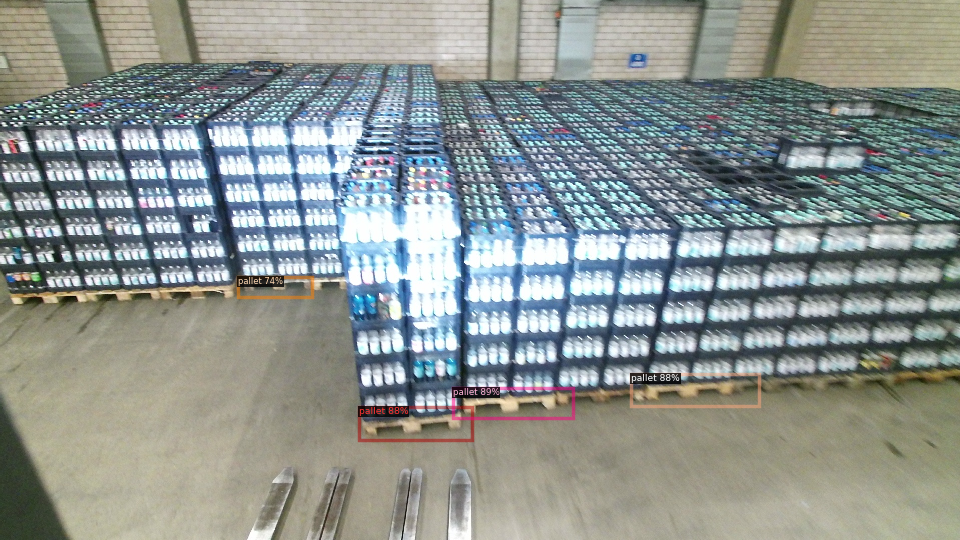

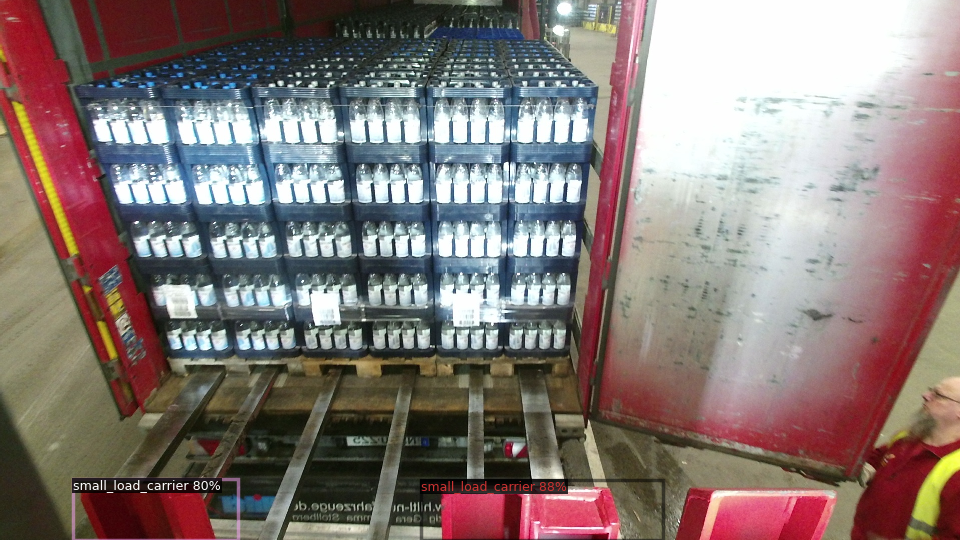

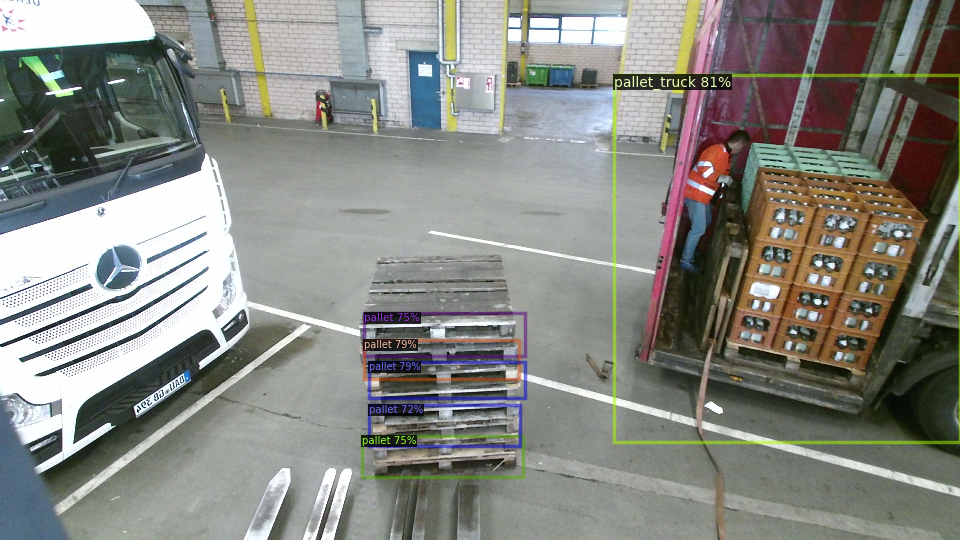

...

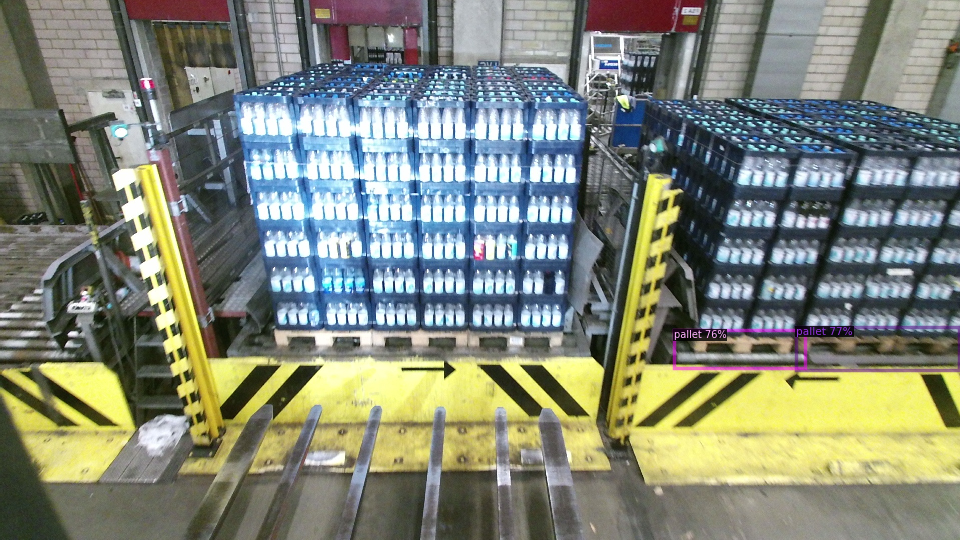

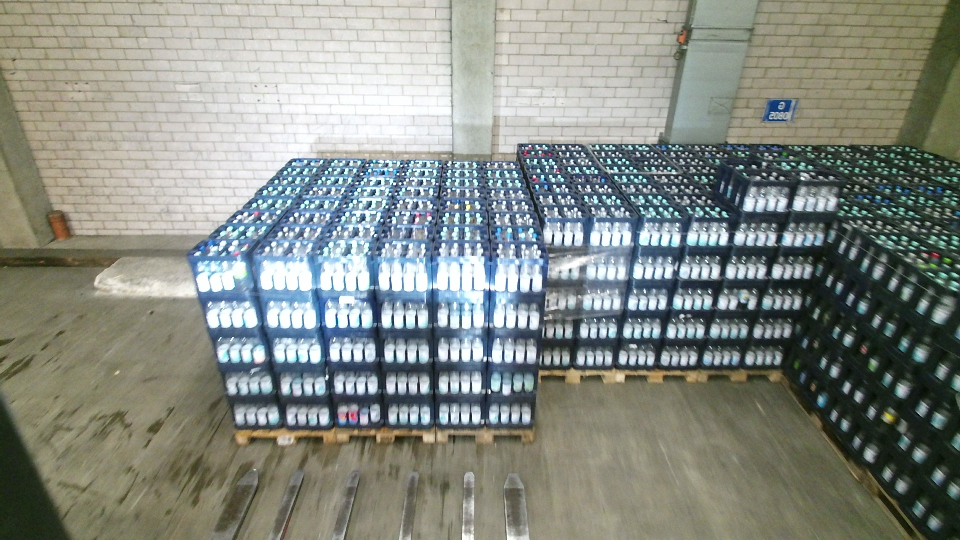

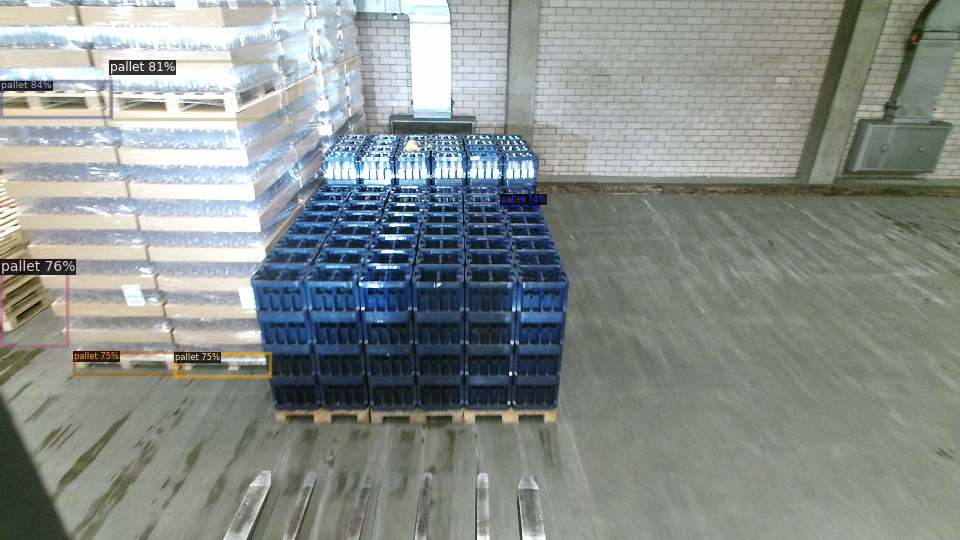

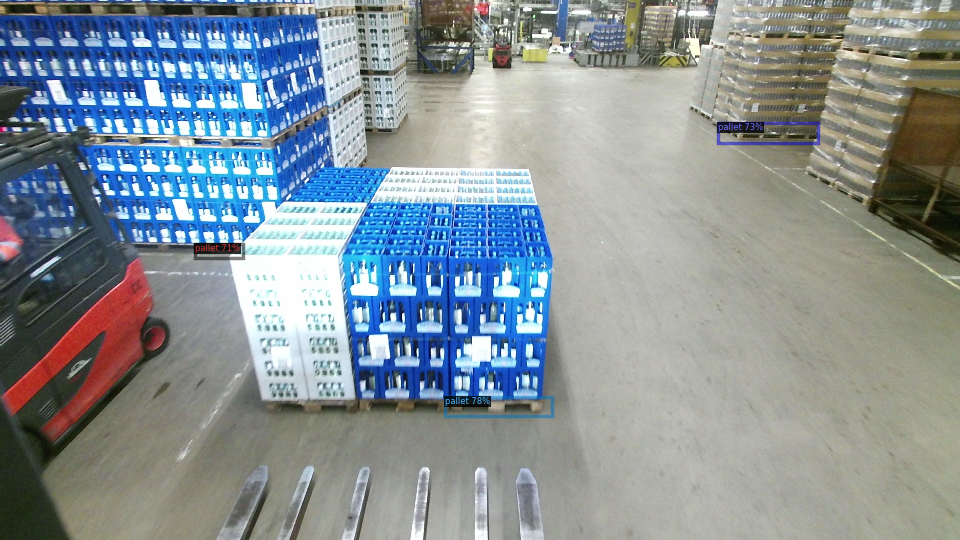

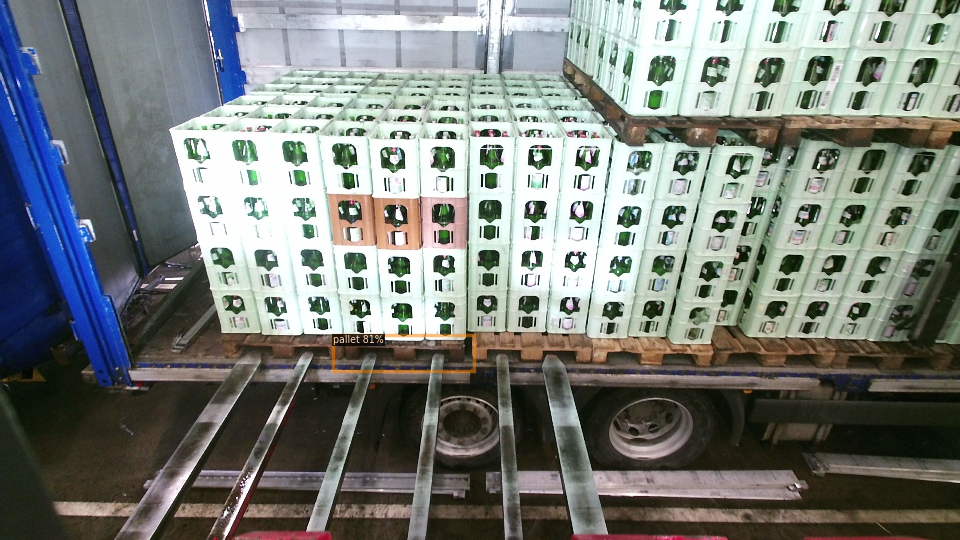

In [15]:
# validation images 
from detectron2.utils.visualizer import ColorMode
#dataset_dicts = val_catalog
for imageName in glob.glob('/content/drive/MyDrive/loco_data/Images_Ashish_I.rar (Unzipped Files)/*jpg'):    
    im = cv2.imread(imageName)
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=train_metadata, 
                   scale=0.5, 
                      # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    # Filename
    filename = '/content/drive/MyDrive/loco_data/predicted/' + imageName + '.jpg'
  
    # Using cv2.imwrite() method
    # Saving the image
    cv2.imwrite(filename, out.get_image()[:, :, ::-1])

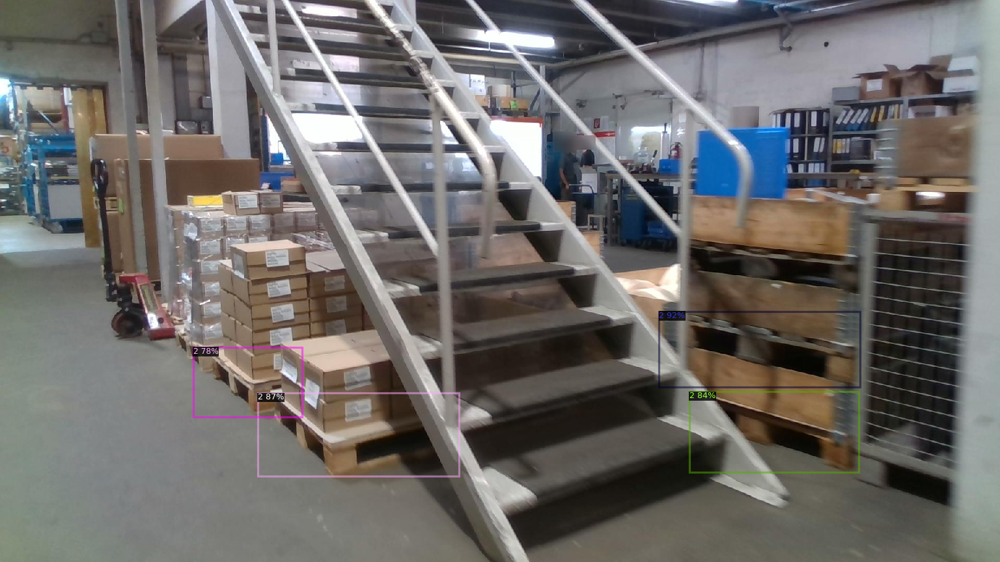

In [ ]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/drive/MyDrive/loco_data/val/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
  break

In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[02/08 13:39:27 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [ ]:
val_metadata = MetadataCatalog.get("my_dataset_val")
val_catalog = DatasetCatalog.get("my_dataset_val")

WARNING [02/08 13:39:31 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[02/08 13:39:31 d2.data.datasets.coco]: Loaded 2277 images in COCO format from /content/loco-sub2-v1-val.json


In [ ]:
# bop to coco

In [ ]:
predictor(cv2.imread('/content/drive/MyDrive/loco_data/val/1564562430367,07.jpg'))

{'instances': Instances(num_instances=0, image_height=1080, image_width=1920, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}

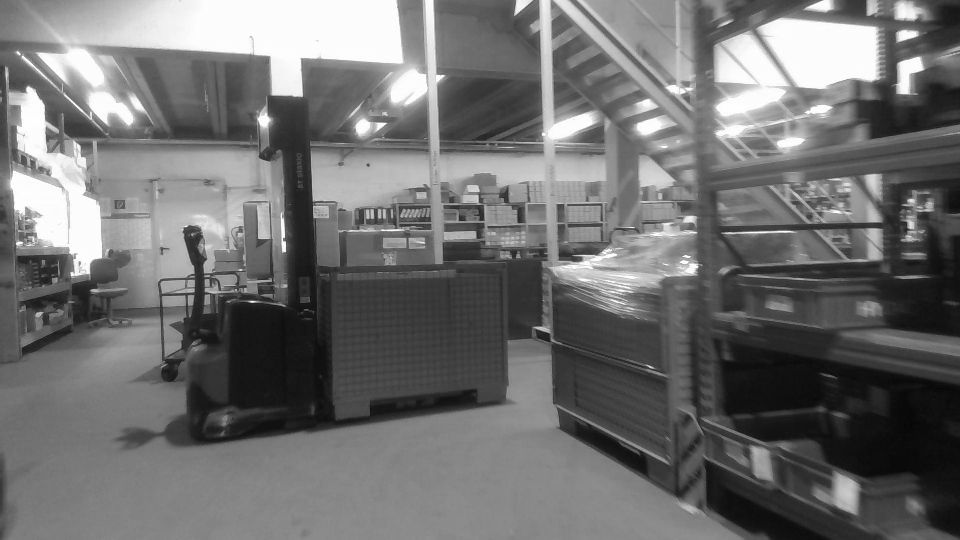

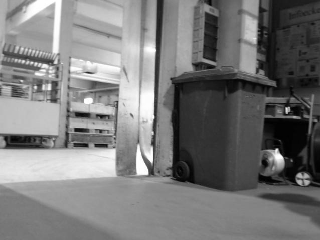

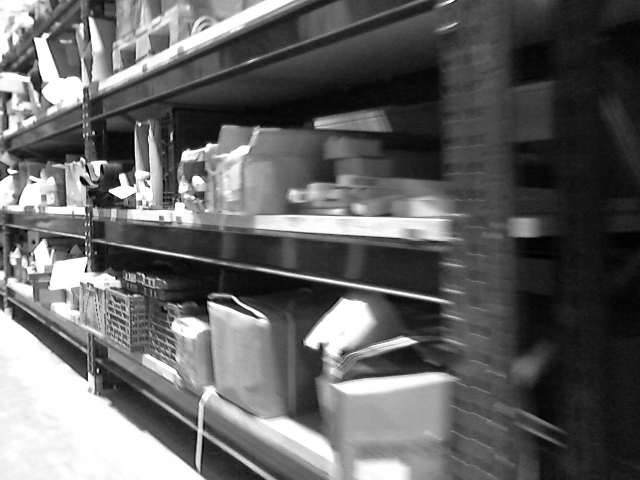

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = val_catalog
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=val_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
# evaluate performance
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("my_dataset_val", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "my_dataset_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[02/07 13:46:11 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [02/07 13:46:12 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[02/07 13:46:12 d2.data.datasets.coco]: Loaded 2277 images in COCO format from /content/loco-sub2-v1-val.json
[02/07 13:46:12 d2.data.build]: Distribution of instances among all 5 categories:
|   category    | #instances   |   category   | #instances   |  category  | #instances   |
|:-------------:|:-------------|:------------:|:-------------|:----------:|:-------------|
| small_load_.. | 8911         |   forklift   | 124          |   pallet   | 52297        |
|   stillage    | 2007         | pallet_truck | 1153         |            |              |
|     total     | 64492        |              |              |            |              |
[02/07 13:46:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShort